So far there are 4 song examples

In [1]:
%cd ../../

/home/molejnik/repos/automatic_tablature_extraction


# Downloading songs

In [ ]:
ydl_opts = {
    "format": "bestaudio/best",
    "outtmpl": "songs/%(title)s.%(ext)s",
    "postprocessors": [
        {
            "key": "FFmpegExtractAudio",
            "preferredcodec": "wav",
            "preferredquality": "192",
        }
    ],
    "postprocessor_args": [
        "-ar",
        "44100",
        #'-ac', '1',
    ],
}

songs_urls = [
    "https://www.youtube.com/watch?v=a4R9Vk5_CbU",  # Ren - Violet's Tale, vocal, acoustic guitar
    "https://www.youtube.com/watch?v=rtL5oMyBHPs",  # MGMT - Little Dark Age, vocal, synthesizer, bass, percussion
    "https://www.youtube.com/watch?v=tAGnKpE4NCI",  # Metallica - Nothing Else Matters, acoustic guitars, vocal, percussion, bass
    "https://www.youtube.com/watch?v=aGSKrC7dGcY",
]  # Depeche Mode - Enjoy The Silence, electric guitar, sythesizer, vocal, percussion, bass?

with yt_dlp.YoutubeDL(ydl_opts) as ydl:
    for url in songs_urls:
        ydl.download([url])

for song in os.listdir("songs/"):
    new_song_name = song.replace("：", " -")
    new_song_name = new_song_name.split(".")[0]
    new_song_name = new_song_name.split("(")[0]
    new_song_name = new_song_name.replace(" -", "")
    new_song_name = new_song_name.replace(" ", "_")[:-1]
    new_song_name = new_song_name.replace("'", "")
    new_song_name += ".wav"
    os.rename(f"songs/{song}", f"songs/{new_song_name}")

# short samples

In [26]:
import librosa as lr
from IPython.display import Audio
from matplotlib import pyplot as plt
import numpy as np
import librosa.display
import soundfile as sf

In [35]:
y, sr = lr.load("data/songs/Metallica_Nothing_Else_Matters.wav", sr=None)
Audio(y, rate=sr)

In [36]:
start_s = 0
end_s = 10


y = y[start_s*sr:end_s*sr]
Audio(y, rate=sr) 

In [37]:
sf.write("data/songs/mettalica_10s.wav", y, sr)

## spectrorgam and waveform

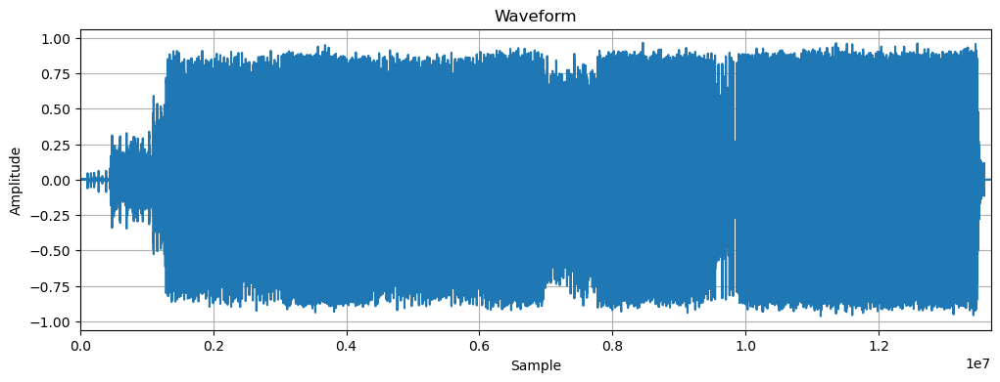

In [18]:
plt.figure(figsize=(12, 4))
plt.plot(y)
plt.title("Waveform")
plt.xlabel("Sample")
plt.ylabel("Amplitude")
plt.xlim(0, len(y))
plt.grid()
plt.show()

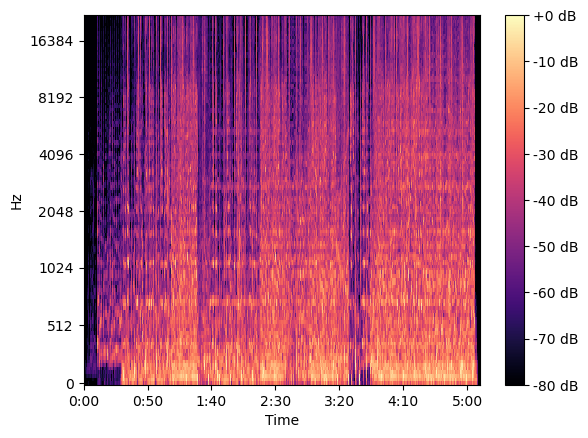

In [19]:
# Passing through arguments to the Mel filters
S = lr.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
fig, ax = plt.subplots()
S_dB = lr.power_to_db(S, ref=np.max)
img = lr.display.specshow(S_dB, x_axis="time", y_axis="mel", sr=sr, fmax=22_000, ax=ax)
fig.colorbar(img, ax=ax, format="%+2.0f dB")
plt.show()


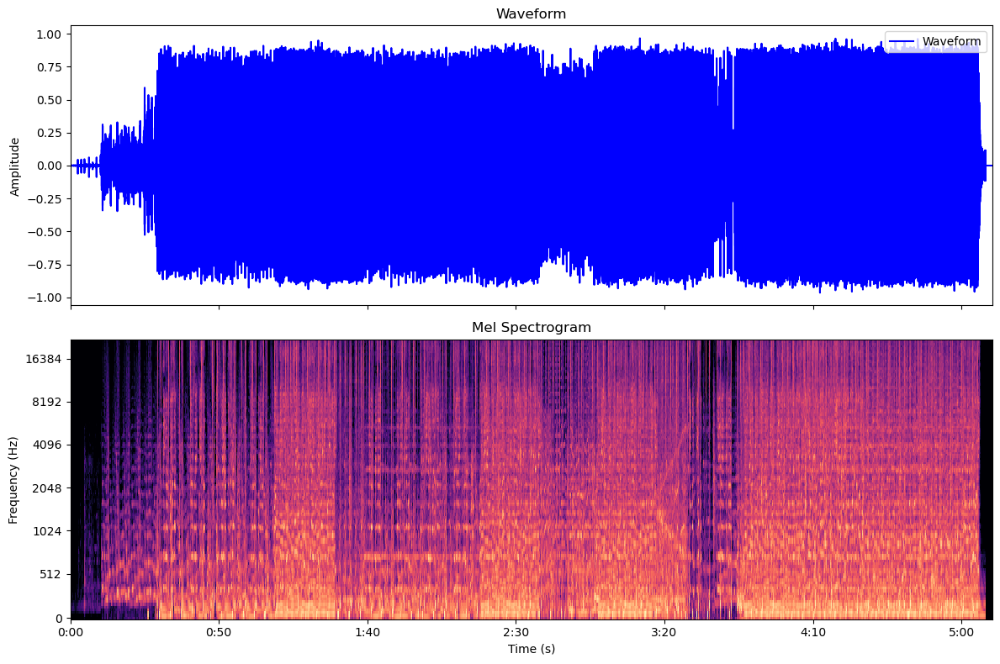

In [23]:
import matplotlib.pyplot as plt
import numpy as np
import librosa as lr

# Example data
samples = np.arange(len(y))  # Sample indices
time = samples / sr  # Convert samples to time

# Generate some data for the second plot
S = lr.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
S_dB = lr.power_to_db(S, ref=np.max)

# Create the figure and subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8), sharex=True)

# Plot the first dataset (waveform)
ax1.plot(time, y, color="blue", label="Waveform")
ax1.set_ylabel("Amplitude")
ax1.set_title("Waveform")
ax1.legend(loc="upper right")

# Plot the second dataset (spectrogram)
img = lr.display.specshow(S_dB, x_axis="time", y_axis="mel", sr=sr, fmax=22050, ax=ax2)
ax2.set_ylabel("Frequency (Hz)")
ax2.set_title("Mel Spectrogram")
#fig.colorbar(img, ax=ax2, format="%+2.0f dB")

# Set the x-axis label for the shared axis
ax2.set_xlabel("Time (s)")

# Adjust layout
plt.tight_layout()
plt.show()